In [162]:
import numpy as np
from pathlib import Path
from util import get_files, check_many
from tqdm.notebook import tqdm
from autoreject import read_auto_reject
from mne import read_epochs, events_from_annotations, Epochs, viz
from mne.io import read_raw_fif
from mne.decoding import SlidingEstimator, cross_val_multiscore, get_coef
from mne.chpi import compute_head_pos, extract_chpi_locs_ctf

from sklearn.utils.class_weight import compute_sample_weight
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.model_selection import StratifiedKFold
from sklearn.svm import SVC, LinearSVC
from sklearn.decomposition import PCA
from sklearn.preprocessing import RobustScaler

import matplotlib.pylab as plt
from matplotlib.colors import Normalize, TwoSlopeNorm

from scipy.stats import spearmanr
from sklearn.utils import resample
from sklearn.linear_model import LinearRegression

In [171]:
def colorbar(mappable):
    from mpl_toolkits.axes_grid1 import make_axes_locatable
    import matplotlib.pyplot as plt
    last_axes = plt.gca()
    ax = mappable.axes
    fig = ax.figure
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    cbar = fig.colorbar(mappable, cax=cax)
    plt.sca(last_axes)
    return cbar

In [2]:
MEG_PROC = Path("/home/mszul/datasets/act_mis/MEG/processed/")
OUTPUT = Path("/home/mszul/datasets/act_mis/outputs/session_selection")

In [3]:
all_fif_paths = get_files(MEG_PROC, "*.fif", strings=["autoreject", "zapline", "observation-epo"])
all_ar_paths = get_files(MEG_PROC, "*.h5", strings=["autoreject", "zapline", "observation-epo"])
sens_ix = np.arange(62, 69)
fif_ar_paths = list(zip(all_fif_paths, all_ar_paths))

In [4]:
selection_criteria = {}

for fif_path, ar_path in tqdm(fif_ar_paths):
    file_key = fif_path.stem
    epochs = read_epochs(fif_path, verbose=False)
    ar = read_auto_reject(ar_path)
    reject_log = ar.get_reject_log(epochs)
    RLL = (reject_log.labels == 1).astype(int)
    selection_criteria[file_key, "reject_log_sensors"] = RLL.mean(axis=0)
    selection_criteria[file_key, "reject_log_trials"] = RLL.mean(axis=1)
    
    x = epochs.get_data(copy=False)
    y = (epochs.events[:,2] == 10).astype(int)

    class_weight = {
        0: np.sum(y == 0),
        1: np.sum(y == 1)
    }

    weights = compute_sample_weight(
        "balanced", y
    )
    fit_kw = {"model__sample_weight": weights}
    
    k_folds = 10
    kf = StratifiedKFold(n_splits=k_folds, shuffle=True)
    cv_iter = kf.split(np.zeros(x.shape), y)
    
    pipeline = Pipeline([
        ("scaler", RobustScaler()),
        ("dim_reduction", PCA(n_components=0.99)),
        ("model", LinearSVC(max_iter=10000, dual=False, penalty="l1"))
    ])

    sliding_decoder = SlidingEstimator(
        pipeline, n_jobs=1, scoring="roc_auc", verbose=True
    )

    scores = cross_val_multiscore(
        sliding_decoder, x, y, cv=cv_iter, fit_params=fit_kw, 
        n_jobs=10, verbose=False
    )
    
    selection_criteria[file_key, "all_sensors_performance"] = scores

  0%|          | 0/62 [00:00<?, ?it/s]

In [ ]:
raw_path = Path("/home/mszul/datasets/act_mis/MEG/processed/0043/act_mis-0043-ses-001-raw.fif")
raw = read_raw_fif(raw_path)

epo_dict = {"obs_congr": 5, "obs_incongr": 10}

events, event_ids = events_from_annotations(
    raw, event_id=epo_dict
)
raw_chpi = extract_chpi_locs_ctf(raw, verbose=False)
head_pos = compute_head_pos(raw.info, raw_chpi, verbose=False)

labels = ["q1", "q2", "q3", "x", "y", "z"]

t_ad = head_pos[:,0]
local_time = t_ad[:11] - t_ad[0]

res = {}
for ix, lab in enumerate(labels):
    hp = head_pos[:,ix+1]
    epoch_results = []
    for b in epoch_times:
        epo_ixes = np.where((t_ad >= b))[0][0]
        mov = hp[epo_ixes:epo_ixes+11]
        epoch_results.append(mov)
    epoch_results = np.array(epoch_results)
    res[lab] = np.std(epoch_results, axis=0)/np.mean(epoch_results, axis=0)

In [5]:
for fif_path, ar_path in tqdm(fif_ar_paths):
    file_key = fif_path.stem
    raw_path = fif_path.parent.joinpath("-".join(fif_path.stem[19:-4].split("-")[:-1]) + "-raw.fif")
    raw = read_raw_fif(raw_path)

    epo_dict = {"obs_congr": 5, "obs_incongr": 10}
    
    events, event_ids = events_from_annotations(
        raw, event_id=epo_dict
    )
    
    epoch_times = raw.times[events[:,0] - raw.first_samp]
    
    raw_chpi = extract_chpi_locs_ctf(raw, verbose=False)
    head_pos = compute_head_pos(raw.info, raw_chpi, verbose=False)

    labels = ["q1", "q2", "q3", "x", "y", "z"]

    t_ad = head_pos[:,0]
    local_time = t_ad[:11] - t_ad[0]

    res = {}
    for ix, lab in enumerate(labels):
        hp = head_pos[:,ix+1]
        epoch_results = []
        for b in epoch_times:
            epo_ixes = np.where((t_ad >= b))[0][0]
            mov = hp[epo_ixes:epo_ixes+11]
            epoch_results.append(mov)
        epoch_results = np.abs(np.array(epoch_results))
        res[lab] = np.std(epoch_results, axis=0)/np.mean(epoch_results, axis=0)
    selection_criteria[file_key, "head_movement"] = res

  0%|          | 0/62 [00:00<?, ?it/s]

Opening raw data file /home/mszul/datasets/act_mis/MEG/processed/0001/act_mis-0001-ses-000-raw.fif...
    Read 5 compensation matrices
    Range : 9589 ... 700940 =      7.991 ...   584.117 secs
Ready.
Current compensation grade : 3
Used Annotations descriptions: ['obs_congr', 'obs_incongr']
Opening raw data file /home/mszul/datasets/act_mis/MEG/processed/0001/act_mis-0001-ses-001-raw.fif...
    Read 5 compensation matrices
    Range : 7286 ... 698755 =      6.072 ...   582.296 secs
Ready.
Current compensation grade : 3
Used Annotations descriptions: ['obs_congr', 'obs_incongr']
Opening raw data file /home/mszul/datasets/act_mis/MEG/processed/0002/act_mis-0002-ses-000-raw.fif...
    Read 5 compensation matrices
    Range : 6677 ... 710695 =      5.564 ...   592.246 secs
Ready.
Current compensation grade : 3
Used Annotations descriptions: ['obs_congr', 'obs_incongr']
Opening raw data file /home/mszul/datasets/act_mis/MEG/processed/0002/act_mis-0002-ses-001-raw.fif...
    Read 5 compensa

Opening raw data file /home/mszul/datasets/act_mis/MEG/processed/0030/act_mis-0030-ses-000-raw.fif...
    Read 5 compensation matrices
    Range : 6590 ... 799435 =      5.492 ...   666.196 secs
Ready.
Current compensation grade : 3
Used Annotations descriptions: ['obs_congr', 'obs_incongr']
Opening raw data file /home/mszul/datasets/act_mis/MEG/processed/0030/act_mis-0030-ses-001-raw.fif...
    Read 5 compensation matrices
    Range : 10126 ... 755472 =      8.438 ...   629.560 secs
Ready.
Current compensation grade : 3
Used Annotations descriptions: ['obs_congr', 'obs_incongr']
Opening raw data file /home/mszul/datasets/act_mis/MEG/processed/0032/act_mis-0032-ses-000-raw.fif...
    Read 5 compensation matrices
    Range : 7969 ... 849679 =      6.641 ...   708.066 secs
Ready.
Current compensation grade : 3
Used Annotations descriptions: ['obs_congr', 'obs_incongr']
Opening raw data file /home/mszul/datasets/act_mis/MEG/processed/0032/act_mis-0032-ses-001-raw.fif...
    Read 5 compens

Opening raw data file /home/mszul/datasets/act_mis/MEG/processed/0049/act_mis-0049-ses-000-raw.fif...
    Read 5 compensation matrices
    Range : 5041 ... 852279 =      4.201 ...   710.232 secs
Ready.
Current compensation grade : 3
Used Annotations descriptions: ['obs_congr', 'obs_incongr']
Opening raw data file /home/mszul/datasets/act_mis/MEG/processed/0049/act_mis-0049-ses-001-raw.fif...
    Read 5 compensation matrices
    Range : 6023 ... 766454 =      5.019 ...   638.712 secs
Ready.
Current compensation grade : 3
Used Annotations descriptions: ['obs_congr', 'obs_incongr']
Opening raw data file /home/mszul/datasets/act_mis/MEG/processed/0050/act_mis-0050-ses-000-raw.fif...
    Read 5 compensation matrices
    Range : 6806 ... 744584 =      5.672 ...   620.487 secs
Ready.
Current compensation grade : 3
Used Annotations descriptions: ['obs_congr', 'obs_incongr']
Opening raw data file /home/mszul/datasets/act_mis/MEG/processed/0050/act_mis-0050-ses-001-raw.fif...
    Read 5 compensa

In [ ]:
labels = ["q1", "q2", "q3", "x", "y", "z"]

f, ax = plt.subplots(3,2, figsize=[10, 7], sharex=True)
ax = ax.flatten()
ax = np.concatenate([ax[::2], ax[1::2]])
t_ad = head_pos[:,0]
local_time = t_ad[:11] - t_ad[0]

res = {}
for ix, lab in enumerate(labels):
    hp = head_pos[:,ix+1]
    epoch_results = []
    for b in epoch_times:
        epo_ixes = np.where((t_ad >= b))[0][0]
        mov = hp[epo_ixes:epo_ixes+11]
        rel_mov = mov - np.mean(mov)
        ax[ix].plot(local_time, mov, lw=0.5, c="black", alpha=0.2)
        epoch_results.append(mov)
    epoch_results = np.array(epoch_results)
    ax[ix].set_ylabel(lab)
    res[lab] = np.std(epoch_results, axis=0)/np.mean(epoch_results, axis=0)
#     ax[ix].plot(t_ad, hp.T)

ax[0].set_title("Rotations (quaternions)")
ax[3].set_title("Translations (mm)")
plt.tight_layout()

In [ ]:
raw_path = fif_path.parent.joinpath("-".join(fif_path.stem[19:-4].split("-")[:-1]) + "-raw.fif")
raw = read_raw_fif(raw_path)

epo_dict = {"obs_congr": 5, "obs_incongr": 10}

events, event_ids = events_from_annotations(
    raw, event_id=epo_dict
)

In [ ]:
events[-1][0] / 1200.0

In [ ]:
9589 / 1200.0

In [ ]:
selection_criteria.keys()

In [7]:
time = np.linspace(-0.1, 1, num=265)
labels = ['q1', 'q2', 'q3', 'x', 'y', 'z']
perf_labels = ["perf_0_55", "perf_0_65", "perf_0_75"]
r = time[::24]
time_ranges = list(zip(r[:-1], r[1:]))

hm_dict = {
    i:[] for i in labels
}

hm_dict["perf_0_55"] = []
hm_dict["perf_0_65"] = []
hm_dict["perf_0_75"] = []

for p in all_fif_paths:
    k = p.stem
    perf = selection_criteria[k, "all_sensors_performance"] 
    hm = selection_criteria[k, "head_movement"]
    
    for l in labels:
        hm_dict[l].append(np.mean(hm[l]))
    
    perf_list = []
    for (b, e) in time_ranges:
        ixes_s = np.where((time > b) & (time <= e))[0]
        perf_list.append(np.mean(perf[:, ixes_s]))
    perf_list = np.array(perf_list)
    
    hm_dict["perf_0_55"].append(perf_list[6])
    hm_dict["perf_0_65"].append(perf_list[7])
    hm_dict["perf_0_75"].append(perf_list[8])

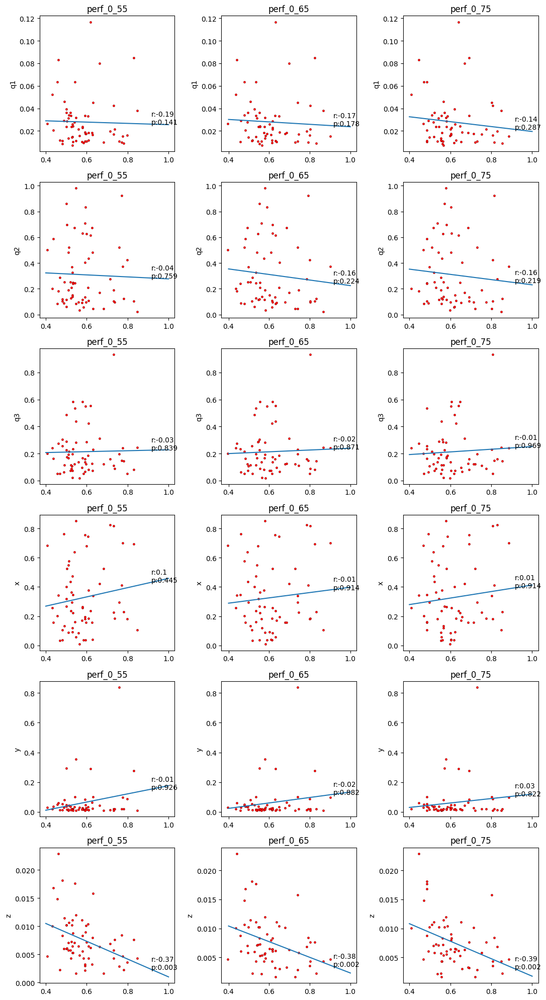

In [9]:
X_surr = np.linspace(0.4, 1.0, num=15)

f, ax = plt.subplots(6, 3, figsize=(11, 20))
for row, rlab in enumerate(labels):
    ax[row,0].set_ylabel(rlab)

    for column, clab in enumerate(perf_labels):
        ax[0,column].set_title(clab)
        
for row, rlab in enumerate(labels):
    for column, clab in enumerate(perf_labels):
        ax[row, column].set_ylabel(rlab)
        ax[row, column].set_title(clab)
        
        ax[row, column].scatter(hm_dict[clab], hm_dict[rlab], c="red", edgecolor="black", linewidths=0.2, s=10)
        coef = np.polyfit(hm_dict[clab], hm_dict[rlab], 1)
        fx = np.poly1d(coef)
        rho, p = spearmanr(hm_dict[clab], hm_dict[rlab])
        ax[row, column].plot(X_surr, fx(X_surr))
        
        ax[row, column].annotate(f"r:{np.round(rho, 2)}\np:{np.round(p, 3)}", [X_surr[-3], fx(X_surr)[-3]])
plt.tight_layout()

In [ ]:
slope, intercept = coef

In [ ]:
def bootsrtap_lr(X, Y, n_boot=100, sam_prop=0.5, r_ls=np.linspace(0, 1, num=15)):
    
    X = np.array(X)
    Y = np.array(Y)
    
    rho_s = []
    p_s = []
    slope_s = []
    inter_s = []
    line_s = []
    for _ in tqdm(range(n_boot)):
        btstrp = resample(np.arange(len(X)), n_samples=int(len(X)*sam_prop))
        coef = np.polyfit(X[btstrp], Y[btstrp], 1)
        slope, inter = coef
        fx = np.poly1d(coef)
        rho, p = spearmanr(X[btstrp], Y[btstrp])
        rho_s.append(rho)
        p_s.append(p)
        slope_s.append(slope)
        inter_s.append(inter)
        line_s.append(fx(r_ls))
    return rho_s, p_s, slope_s, inter_s, line_s

In [ ]:
X, Y = hm_dict[clab], hm_dict[rlab]
res = bootsrtap_lr(X, Y, n_boot=1000, sam_prop=0.5, r_ls=np.linspace(0.4, 1, num=15))
Ymx = np.squeeze(res[-1])

In [ ]:
f, ax = plt.subplots(figsize=(3, 3))
Xx = np.linspace(0.4,1, num=15)
ax.scatter(X, Y, edgecolor="black", linewidths=0.55, s=15, c="red")
ax.plot(
    Xx, 
    np.percentile(Ymx, 0.5, axis=0), 
    lw=0.5, 
    c="black"
)
ax.fill_between(
    Xx,
    np.percentile(Ymx, 0.025, axis=0),
    np.percentile(Ymx, 0.925, axis=0),
    linewidth=0.0,
    alpha=0.2,
    color="black"    
)

In [ ]:
fx = np.poly1d((np.percentile(res[2], 0.75), np.percentile(res[3], 0.75)))


f, ax = plt.subplots(figsize=(7, 3))
Xx = np.linspace(0.4,1, num=15)
ax.scatter(X, Y, edgecolor="black", linewidths=0.55, s=15, c="red")
ax.plot(
    Xx, 
    fx(Xx), 
    lw=0.5, 
    c="black"
)


In [35]:
ch_labs = np.unique([i[:-2] for i in epochs.ch_names])
col_ch_lab = np.linspace(0, 1, num=len(ch_labs))
dict_s = {ch_labs[i]: col_ch_lab[i] for i, k in enumerate(ch_labs)}
map_d = np.array([dict_s[i[:-2]] for i in epochs.ch_names])

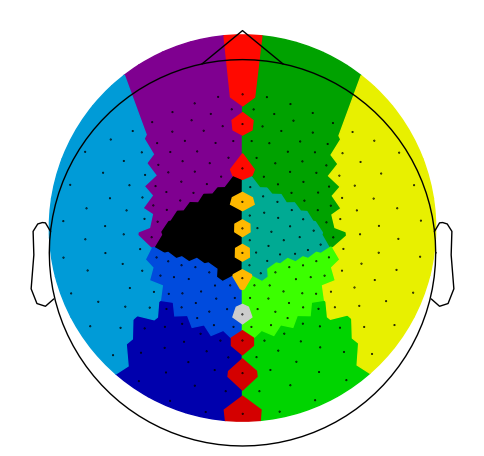

In [64]:
f, ax = plt.subplots(1,1, figsize=(6,7))
delta = viz.plot_topomap(
    map_d,
    epochs.info,
    sphere=(0, -0.025, 0, 0.195),
    cmap="nipy_spectral",
    axes=ax,
    show=False,
    image_interp="nearest",
    contours=0
)

In [62]:
channel_labels = [
    ["MLC", "MZC"],
    ["MRC", "MZC"],
    ["MLF", "MZF"],
    ["MRF", "MZF"],
    ["MLO", "MZO"],
    ["MRO", "MZO"],
    ["MLP", "MZP"],
    ["MRP", "MZP"],
    ["MRT"],
    ["MLT"],
]

In [138]:
epochs = read_epochs(fif_path, verbose=False)
ch_subs_names = {}
ch_subs_indexes = {}
for ch_l in channel_labels:
    ch_subset = [i for i in epochs.ch_names if check_many(ch_l, i, func="any")]
    ch_key = ch_l[0]
    ch_subs_names[ch_key] = ch_subset
    ch_subs_indexes[ch_key] = [ch_ix for ch_ix, ch in enumerate(epochs.ch_names) if check_many(ch_subset, ch, func="any")]

In [66]:
subset_perf = {}

for fif_path, ar_path in tqdm(fif_ar_paths):
    file_key = fif_path.stem
    epochs = read_epochs(fif_path, verbose=False)
    for ch_l in channel_labels:
        ch_key = ch_l[0]
        print(ch_key)
        ch_subset = [i for i in epochs.ch_names if check_many(ch_l, i, func="any")]
        x = epochs.copy().pick(ch_subset).get_data(copy=True)
        y = (epochs.events[:,2] == 10).astype(int)

        class_weight = {
            0: np.sum(y == 0),
            1: np.sum(y == 1)
        }

        weights = compute_sample_weight(
            "balanced", y
        )
        fit_kw = {"model__sample_weight": weights}

        k_folds = 10
        kf = StratifiedKFold(n_splits=k_folds, shuffle=True)
        cv_iter = kf.split(np.zeros(x.shape), y)

        pipeline = Pipeline([
            ("scaler", RobustScaler()),
            ("dim_reduction", PCA(n_components=0.99)),
            ("model", LinearSVC(max_iter=10000, dual=False, penalty="l1"))
        ])

        sliding_decoder = SlidingEstimator(
            pipeline, n_jobs=1, scoring="roc_auc", verbose=True
        )

        scores = cross_val_multiscore(
            sliding_decoder, x, y, cv=cv_iter, fit_params=fit_kw, 
            n_jobs=10, verbose=False
        )
        subset_perf[(file_key, ch_key)] = scores

  0%|          | 0/62 [00:00<?, ?it/s]

MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT
MLC
MRC
MLF
MRF
MLO
MRO
MLP
MRP
MRT
MLT


/tmp/ipykernel_32776/219578709.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  f, ax = plt.subplots(1, 12, figsize=(20,3), width_ratios=[2.5, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])


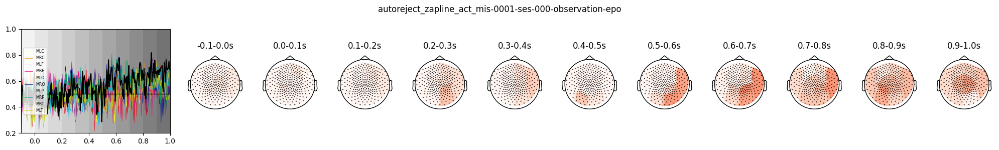

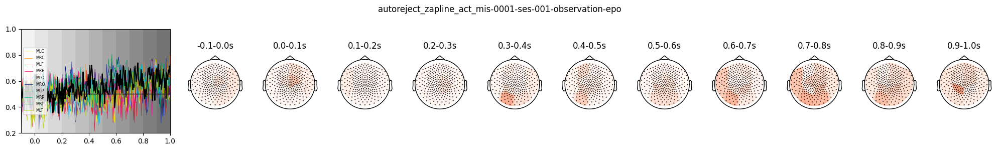

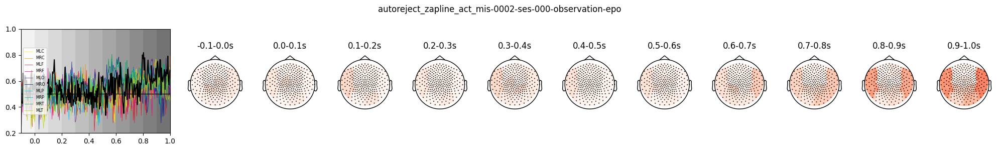

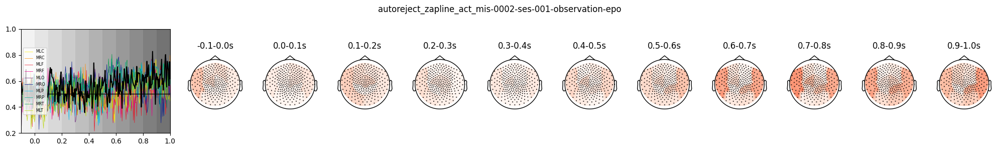

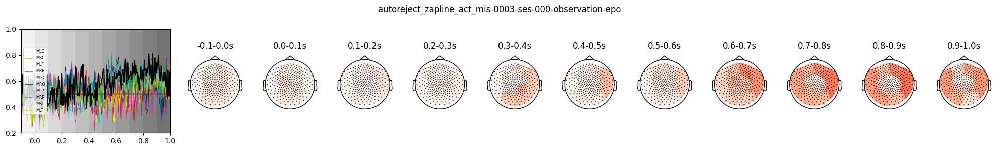

...

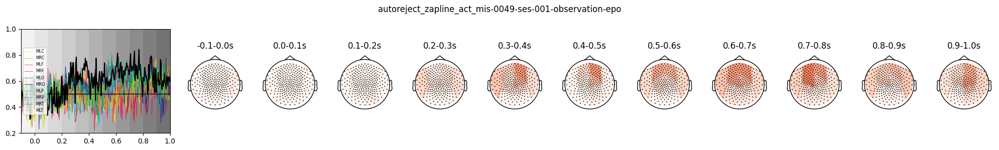

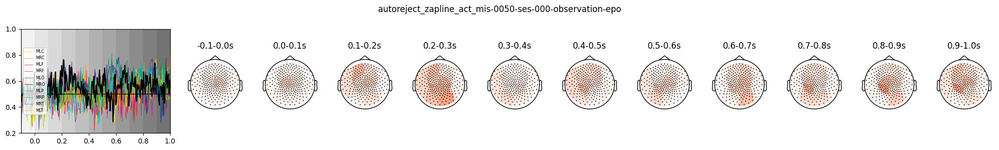

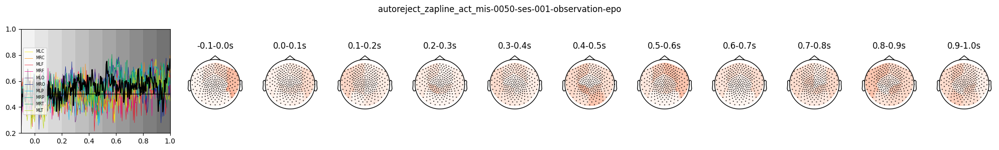

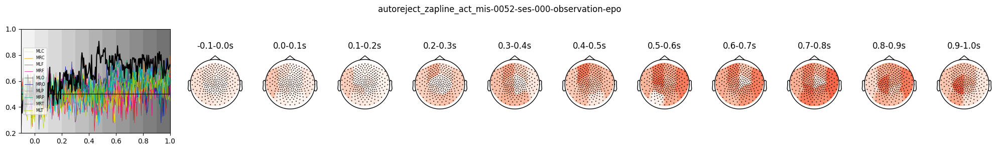

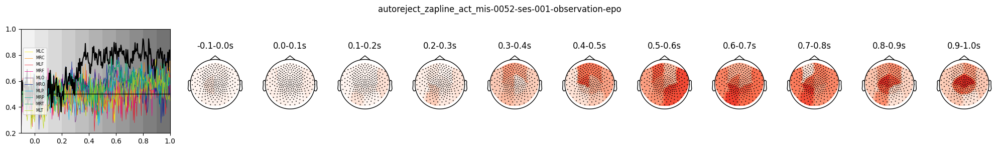

In [213]:
COLOR_PALETTE = [
    "#fff100", "#ff8c00", "#e81123", "#ec008c", "#68217a", 
    "#00188f", "#00bcf2", "#00b294", "#009e49", "#bad80a"
]
SUBSET_LABELS = [ch_l[0] for ch_l in channel_labels]
time = np.linspace(-0.1,1, num=265)

r = time[::24]
time_ranges = list(zip(r[:-1], r[1:]))
time_ranges[6:9]


for fif in all_fif_paths:
    bF = fif.stem

    f, ax = plt.subplots(1, 12, figsize=(20,3), width_ratios=[2.5, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

    for ix, K in enumerate(SUBSET_LABELS):
        data = subset_perf[(bF, K)]
        mean = np.mean(subset_perf[(all_fif_paths[0].stem, K)], axis=0)
        ax[0].plot(time, mean, c=COLOR_PALETTE[ix], label=K, lw=0.5)

    for tz_ix, timez in enumerate(time_ranges):
        h = np.where((time > timez[0]) & (time <= timez[1]))[0]
        ax[tz_ix+1].set_title(f"{np.round(timez[0],2)}-{np.round(timez[1],2)}s")
        viz_data = np.zeros(274)
        for ix, K in enumerate(SUBSET_LABELS):
            viz_data[ch_subs_indexes[K]] = np.mean(subset_perf[(bF, K)][:,h])
        delta = viz.plot_topomap(
            viz_data,
            epochs.info,
            sphere=(0, -0.025, 0, 0.195),
            cmap="Reds",
            axes=ax[tz_ix+1],
            show=False,
            image_interp="cubic",
            cnorm=Normalize(vmin=0.50, vmax=0.90),
            contours=0
        ) 
        
        ax[0].axvspan(timez[0], timez[1], color="black", alpha=0.05*(tz_ix+1), lw=0)
    mean_all_sensors = np.mean(selection_criteria[bF, "all_sensors_performance"], axis=0)
    ax[0].plot(time, mean_all_sensors, c="black", lw=1.5)
    ax[0].legend(fontsize="xx-small", loc=6)
    ax[0].axhline(0.5, lw=1, c="black")
    ax[0].set_ylim(0.2, 1.0)
    ax[0].set_xlim(-0.1, 1)
    f.suptitle(bF)
    plt.tight_layout()
    plt.savefig(f"/scratch/act_vis_mism/{bF}.svg")

In [101]:
r = time[::24]
time_ranges = list(zip(r[:-1], r[1:]))

In [76]:
subset_perf[(all_fif_paths[0].stem, K)].shape

(10, 265)

In [102]:
bF = all_fif_paths[8].stem

In [139]:
r = time[::24]
time_ranges = list(zip(r[:-1], r[1:]))
time_ranges[6:9]

[(0.5, 0.6), (0.6, 0.7000000000000001), (0.7000000000000001, 0.8)]

In [160]:
viz_data = np.zeros(274)
for ix, K in enumerate(SUBSET_LABELS):
    viz_data[ch_subs_indexes[K]] = np.mean(subset_perf[(bF, K)][:,h])

In [141]:
for timez in time_ranges[6:9]:
    h = np.where((time > b) & (time <= e))[0]

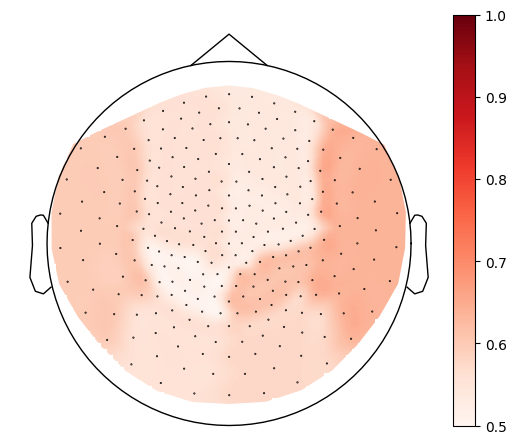

In [177]:
f, ax = plt.subplots(1,1, figsize=(6,7))
delta = viz.plot_topomap(
    viz_data,
    epochs.info,
    sphere=(0, -0.025, 0, 0.195),
    cmap="Reds",
    axes=ax,
    show=False,
    image_interp="cubic",
    cnorm=Normalize(vmin=0.50, vmax=1.0),
    contours=0
)
colorbar(delta[0])

In [210]:
len(time_ranges)

11

'0.7-0.8s'

In [ ]:
delta